Author: Darian Hadjiabadi | CS231N Final project

I want to generate realistic neuron morphologies. Here, I attempt to do this for the granule cells.
Specifically, this notebook covers the engineering steps necessary to train a respectable DGCAN model for generation
of realistic granule cell dendritic arborizations. Data is loaded in from the folder 'database-imgs-full/granule/train/a'.

In [1]:
import numpy as np
import sys
import os

import torch
import torch.nn as nn
from torch.nn import init
import torchvision
import torchvision.transforms as T
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler
import torchvision.datasets as dset

from gan.network_utils import run_a_gan
from gan.network_utils import show_images
from gan.network_utils import initialize_weights
from gan.network_utils import gan_generate
from gan.network_utils import count_params
from gan.network_utils import save_model
from gan.network_utils import load_model
from gan.network import discriminator
from gan.network import dc_discriminator
from gan.network import vanilla_discriminator_loss
from gan.network import ls_discriminator_loss
from gan.network import generator
from gan.network import dc_generator
from gan.network import vanilla_generator_loss
from gan.network import ls_generator_loss

from gan.network import get_optimizer


import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline

%load_ext autoreload
%autoreload 2

plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'




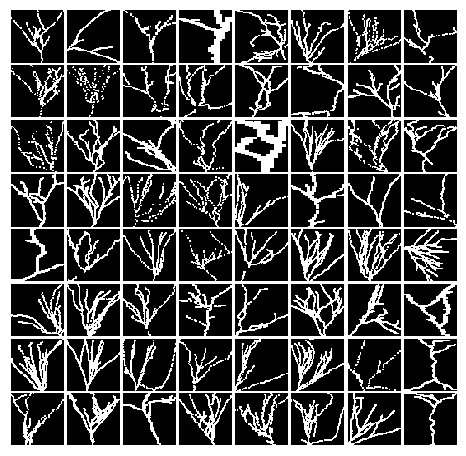

In [2]:
# ChunkSampler class taken from assignment3/GANs-PyTorch.ipynb

class ChunkSampler(sampler.Sampler):
    """Samples elements sequentially from some offset. 
    Arguments:
        num_samples: # of desired datapoints
        start: offset where we should start selecting from
    """
    def __init__(self, num_samples, start=0):
        self.num_samples = num_samples
        self.start = start

    def __iter__(self):
        return iter(range(self.start, self.start + self.num_samples))

    def __len__(self):
        return self.num_samples


NUM_TRAIN = 2500
NUM_TEST  = 64
batch_size = 64

cell_type = 'granule'
neuron_train = dset.ImageFolder('./database-imgs-full/' + cell_type + '/train/', transform=T.ToTensor())
neuron_test  = dset.ImageFolder('./database-imgs-full/' + cell_type + '/test/', transform=T.ToTensor())
loader_train = DataLoader(neuron_train, batch_size=batch_size,
                          sampler=ChunkSampler(NUM_TRAIN, 0))


imgs = loader_train.__iter__().next()[0][:,0,:,:].view(batch_size, -1).numpy().squeeze()
show_images(imgs)

# Let's view some neurons!


At this stage I am going to test the GAN variants to make sure they can run. I will run hyperparameter search after.

In [3]:

def vanilla_gan_run(dtype, lrd, lrg, beta1, beta2, num_epochs=100, show=True, return_model=False):
    # Make the discriminator
    D = discriminator().type(dtype)
    # Make the generator
    G = generator().type(dtype)

    # Use the function you wrote earlier to get optimizers for the Discriminator and the Generator
    D_solver = get_optimizer(D, lr=lrd, beta1=beta1, beta2=beta2)
    G_solver = get_optimizer(G, lr=lrg, beta1=beta1, beta2=beta2)
    # Run it!
    d_loss_list, g_loss_list, fake_imgs, D, G = run_a_gan(loader_train, dtype, D, G, D_solver, G_solver, vanilla_discriminator_loss, vanilla_generator_loss,num_epochs=num_epochs,show=show)
    if return_model:
        return d_loss_list, g_loss_list, fake_imgs, D, G
    else:
        return d_loss_list, g_loss_list, fake_imgs


def ls_gan_run(dtype, lrd, lrg, beta1, beta2, num_epochs=100, show=True, return_model=False):
    # Make the discriminator
    D = discriminator().type(dtype)
    # Make the generator
    G = generator().type(dtype)

    # Use the function you wrote earlier to get optimizers for the Discriminator and the Generator
    D_solver = get_optimizer(D, lr=lrd, beta1=beta1, beta2=beta2)
    G_solver = get_optimizer(G, lr=lrg, beta1=beta1, beta2=beta2)
    # Run it!
    d_loss_list, g_loss_list, fake_imgs, D, G = run_a_gan(loader_train, dtype, D, G, D_solver, G_solver, ls_discriminator_loss, ls_generator_loss,num_epochs=num_epochs, show=show)
    if return_model:
        return d_loss_list, g_loss_list, fake_imgs, D, G
    else:
        return d_loss_list, g_loss_list, fake_imgs


def dg_gan_run(dtype, lrd, lrg, beta1, beta2, num_epochs=25, show=True, return_model=False, batch_size=64, label_smoothing=False, instance_noise=False):

    D_DC = dc_discriminator(batch_size).type(dtype) 
    D_DC.apply(initialize_weights)
    G_DC = dc_generator(batch_size).type(dtype)
    G_DC.apply(initialize_weights)

    D_DC_solver = get_optimizer(D_DC, lr=lrd, beta1=beta1, beta2=beta2)
    G_DC_solver = get_optimizer(G_DC, lr=lrg, beta1=beta1, beta2=beta2)
    d_loss_list, g_loss_list, fake_imgs, D, G = run_a_gan(loader_train, dtype, D_DC, G_DC, D_DC_solver, G_DC_solver, vanilla_discriminator_loss, 
                                                          vanilla_generator_loss,num_epochs=num_epochs, show=show, label_smoothing=label_smoothing, 
                                                          instance_noise=instance_noise)
    if return_model:
        return d_loss_list, g_loss_list, fake_imgs, D, G
    else:
        return d_loss_list, g_loss_list, fake_imgs



In [4]:

def plot_loss(d_list, g_list, title=None):
    fig = plt.figure()
    t = np.arange(len(d_list))
    plt.plot(t, d_list,'r')
    plt.plot(t, g_list,'b')
    plt.legend(['Discriminator loss', 'Generator loss'])
    if title is not None:
        plt.title(title)

# save images to output directory
def count_to_str(count):
    if count < 10:
        return '00000' + str(count)
    elif count >= 10 and count < 100:
        return '0000' + str(count)
    elif count >= 100 and count < 1000:
        return '000' + str(count)
    elif count >= 1000 and count < 10000:
        return '00' + str(count)
    elif count >= 10000 and count < 100000:
        return '0' + str(count)
    
def save_imgs(imgs, dir_path):
    import scipy.misc
    imgs = np.reshape(fake_imgs, [imgs.shape[0], -1])
    sqrtimg = int(np.ceil(np.sqrt(imgs.shape[1])))
    imgs = np.reshape(imgs, (imgs.shape[0], sqrtimg, sqrtimg))
    
    for i in range(imgs.shape[0]):
        nstr = count_to_str(i)
        fn_full = 'img-' + nstr + '.png'
        scipy.misc.imsave(dir_path + fn_full, imgs[i,:,:])        



In [5]:
def hyperparameter_search_v2(gan_variant, dtype, search_length=2):
    f, num_epochs = None, None
    if gan_variant == 'vanilla':
        f = vanilla_gan_run
        num_epochs = 50
    elif gan_variant == 'ls':
        f = ls_gan_run
        num_epochs = 50
    elif gan_variant == 'dc':
        f = dg_gan_run
        num_epochs = 25
        
    lrs = 10 ** np.random.uniform(low=-5, high=-2, size=search_length)
    lrs = np.insert(lrs, 1, [2.5e-4, 5.0e-4])
    print(lrs)
    results = {}
    for lr in lrs:
        print('START: lr %0.8f' % (lr))
        d_loss_list, g_loss_list, fake_imgs, D, G = f(dtype, lr, lr, 0.50, 0.999, num_epochs=num_epochs, show=False, return_model=True)
        results[lr] = (d_loss_list, g_loss_list, fake_imgs, D, G)
        
    return results
                
    

In [6]:
#Vanilla GAN hyperparameter (learning-rate) search using random search

dtype = torch.cuda.FloatTensor
results_van = hyperparameter_search_v2('vanilla', dtype, search_length=18)


[5.06988038e-04 2.50000000e-04 5.00000000e-04 3.54979536e-05
 1.86163876e-03 2.81635549e-05 3.77607115e-03 3.97525573e-05
 5.73694990e-04 2.94957332e-03 1.50132448e-03 1.41088203e-05
 3.58920868e-03 5.26085398e-05 1.85590573e-05 1.88222239e-04
 7.43348548e-04 1.89772888e-05 1.30693506e-04 7.39904606e-04]
START: lr 0.00050699
START: lr 0.00025000
START: lr 0.00050000
START: lr 0.00003550
START: lr 0.00186164
START: lr 0.00002816
START: lr 0.00377607
START: lr 0.00003975
START: lr 0.00057369
START: lr 0.00294957
START: lr 0.00150132
START: lr 0.00001411
START: lr 0.00358921
START: lr 0.00005261
START: lr 0.00001856
START: lr 0.00018822
START: lr 0.00074335
START: lr 0.00001898
START: lr 0.00013069
START: lr 0.00073990


In [7]:
#LS GAN hyperparameter (learning-rate) search using random search

dtype = torch.cuda.FloatTensor
results_ls = hyperparameter_search_v2('ls', dtype, search_length=18)


[1.35605891e-05 2.50000000e-04 5.00000000e-04 4.93765612e-04
 6.41676151e-04 1.98607517e-04 1.33454500e-04 1.43187682e-05
 3.15148544e-03 2.62090328e-03 9.62311617e-03 6.71098317e-04
 8.83196446e-05 8.62291362e-03 9.63192287e-04 8.54368682e-03
 1.71737355e-04 4.67326702e-05 6.41702853e-03 7.08663544e-05]
START: lr 0.00001356
START: lr 0.00025000
START: lr 0.00050000
START: lr 0.00049377
START: lr 0.00064168
START: lr 0.00019861
START: lr 0.00013345
START: lr 0.00001432
START: lr 0.00315149
START: lr 0.00262090
START: lr 0.00962312
START: lr 0.00067110
START: lr 0.00008832
START: lr 0.00862291
START: lr 0.00096319
START: lr 0.00854369
START: lr 0.00017174
START: lr 0.00004673
START: lr 0.00641703
START: lr 0.00007087


In [6]:
#DCGAN hyperparameter (learning-rate) search using random search

dtype = torch.cuda.FloatTensor
results_dg = hyperparameter_search_v2('dc', dtype, search_length=18)


[1.73535163e-03 2.50000000e-04 5.00000000e-04 1.45373894e-04
 2.97398063e-04 5.01213841e-04 2.77007273e-05 5.95108294e-04
 1.98800722e-05 7.26754535e-05 2.26429471e-05 4.26797264e-05
 1.06303541e-04 9.48992114e-04 4.62127307e-05 8.47298381e-04
 9.91106449e-05 6.60380770e-03 2.22947252e-05 4.74830644e-04]
START: lr 0.00173535
START: lr 0.00025000
START: lr 0.00050000
START: lr 0.00014537
START: lr 0.00029740
START: lr 0.00050121
START: lr 0.00002770
START: lr 0.00059511
START: lr 0.00001988
START: lr 0.00007268
START: lr 0.00002264
START: lr 0.00004268
START: lr 0.00010630
START: lr 0.00094899
START: lr 0.00004621
START: lr 0.00084730
START: lr 0.00009911
START: lr 0.00660381
START: lr 0.00002229
START: lr 0.00047483


/home/shared/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


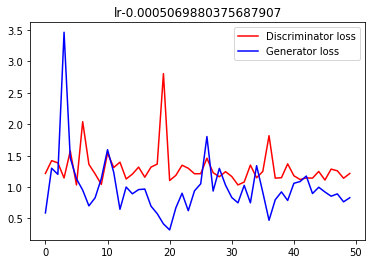

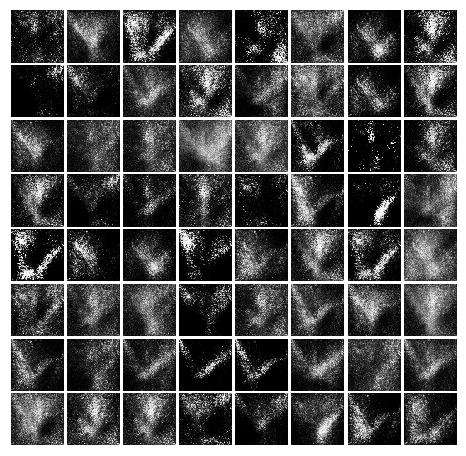

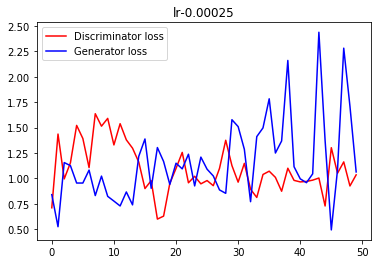

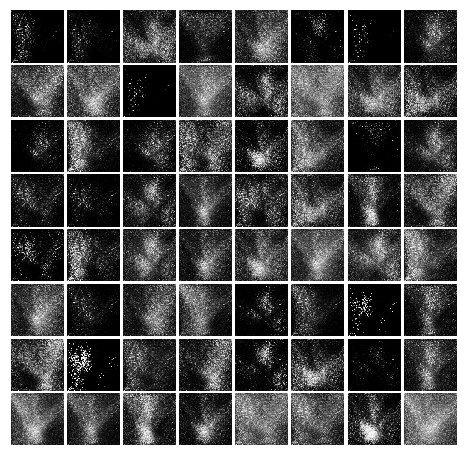

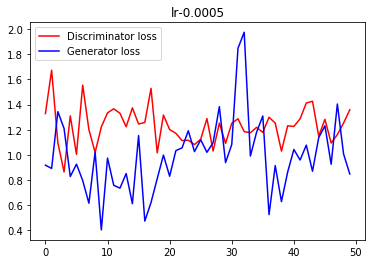

...

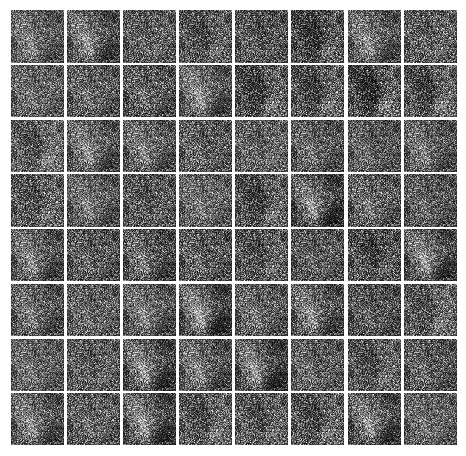

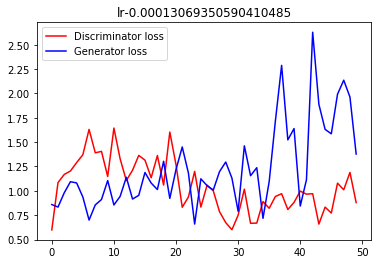

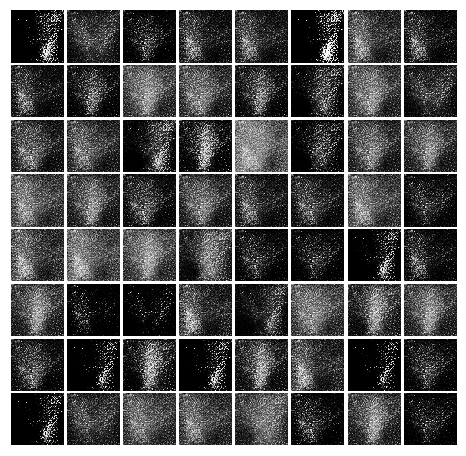

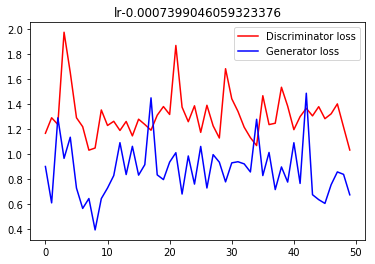

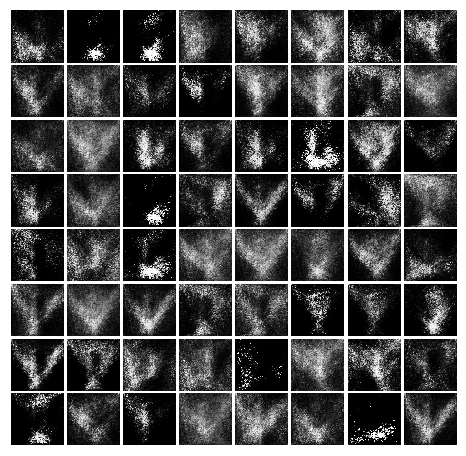

In [8]:
# Show vanilla GAN loss curves and sample generated images
for lr in results_van.keys():
    title = 'lr-' + str(lr)
    d_loss_list, g_loss_list, fake_imgs, _, G = results_van[lr]
    plot_loss(d_loss_list, g_loss_list, title=title)
    test_imgs = gan_generate(dtype, G)
    show_images(test_imgs)


/home/shared/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


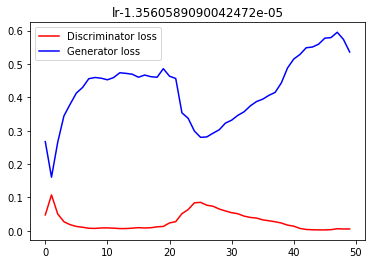

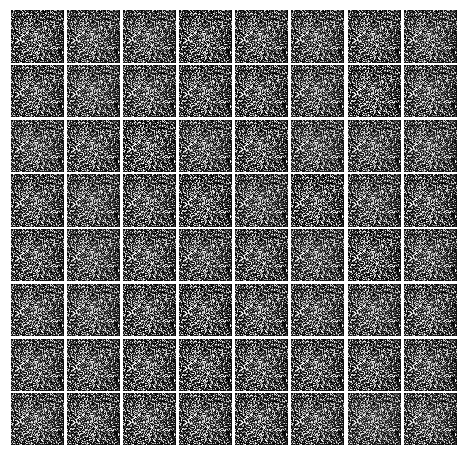

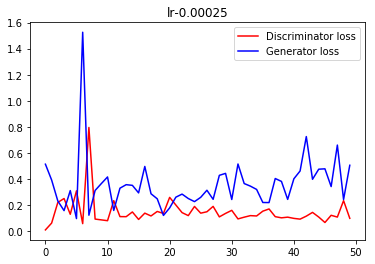

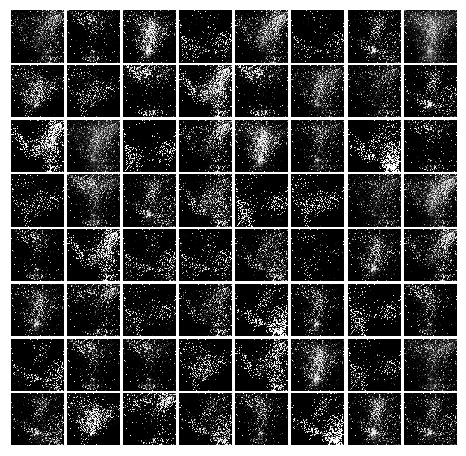

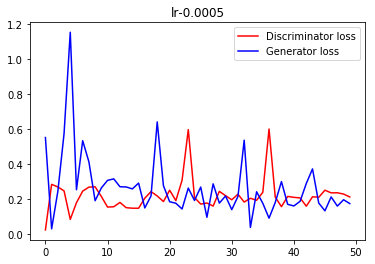

...

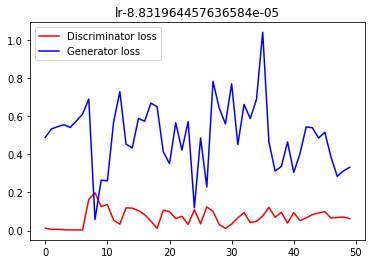

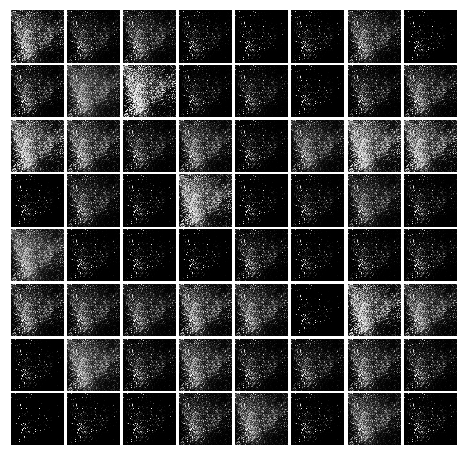

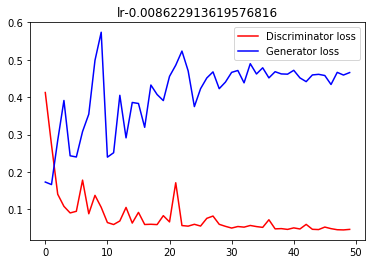

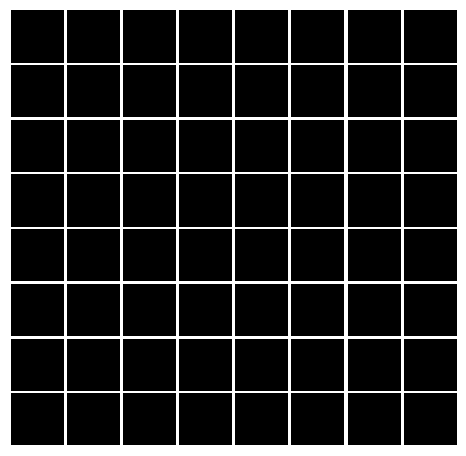

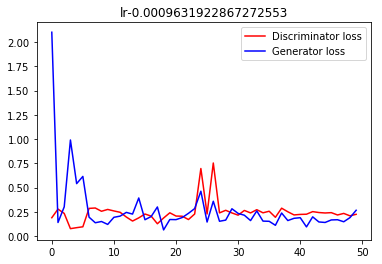

In [ ]:
# Show LS-GAN loss curves and sample generated images
for lr in results_ls.keys():
    title = 'lr-' + str(lr)
    d_loss_list, g_loss_list, fake_imgs, _, G = results_ls[lr]
    plot_loss(d_loss_list, g_loss_list, title=title)
    test_imgs = gan_generate(dtype, G)
    show_images(test_imgs)


/home/shared/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


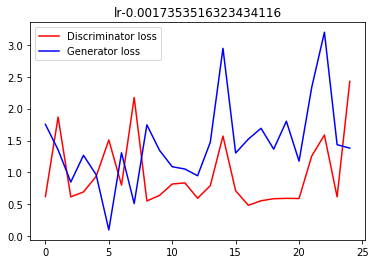

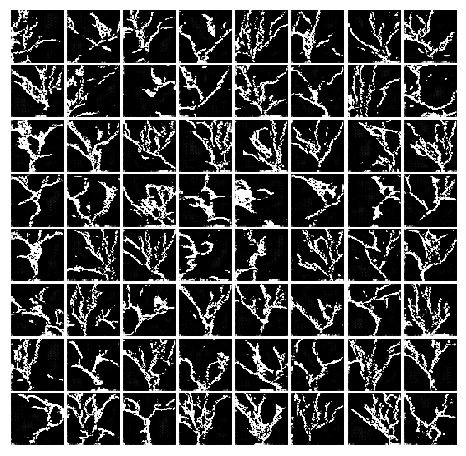

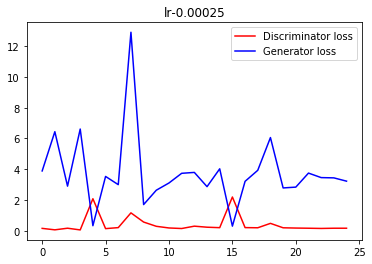

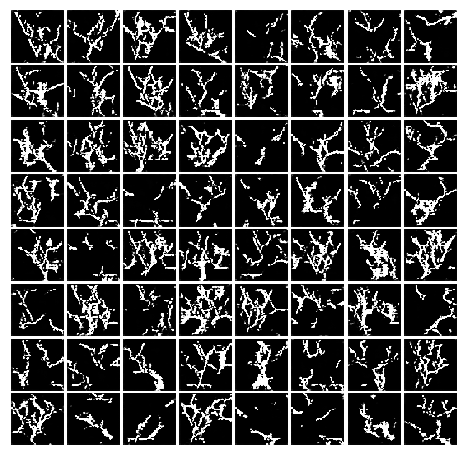

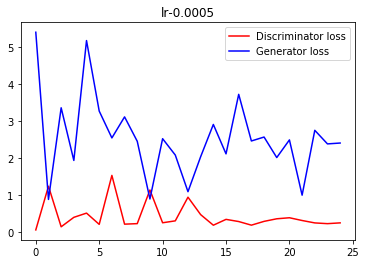

...

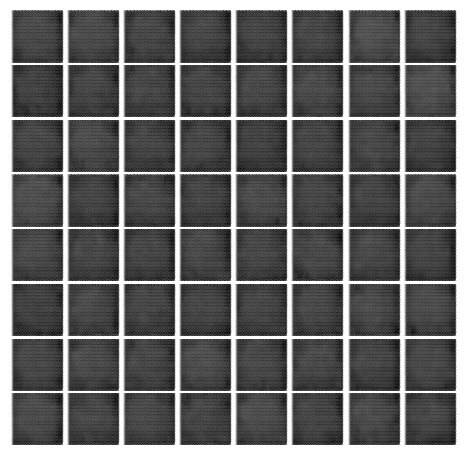

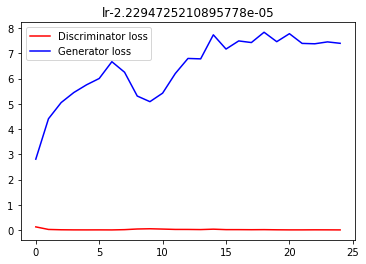

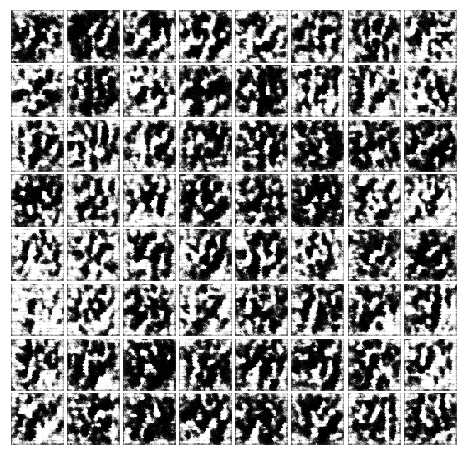

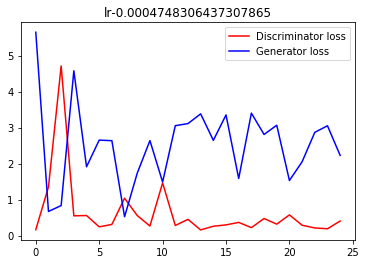

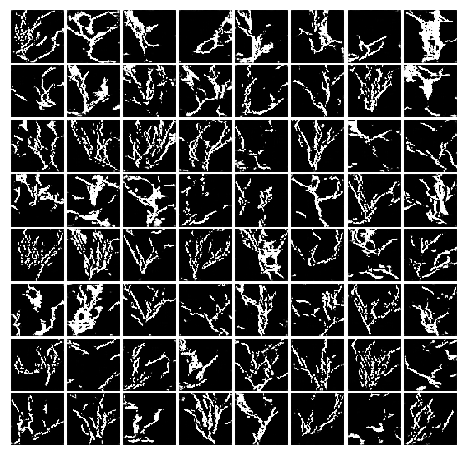

In [7]:
# Show DCGAN loss curves and sample generated images
for lr in results_dg.keys():
    title = 'lr-' + str(lr)
    d_loss_list, g_loss_list, fake_imgs, _, G = results_dg[lr]
    plot_loss(d_loss_list, g_loss_list, title=title)
    test_imgs = gan_generate(dtype, G)
    show_images(test_imgs)


Having identified the ideal learning rate, I will train a DCGAN for 100 epochs, and save the model


0.00059510829414641
lr-0.00059510829414641-ls-0-in-0
Iter: 0, D: 1.409, G:1.018


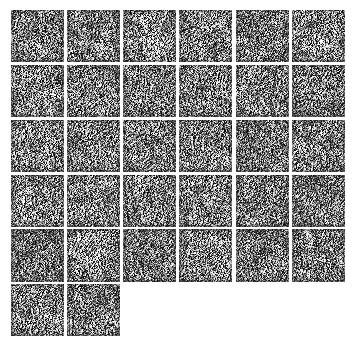


Iter: 100, D: 1.014, G:0.6829


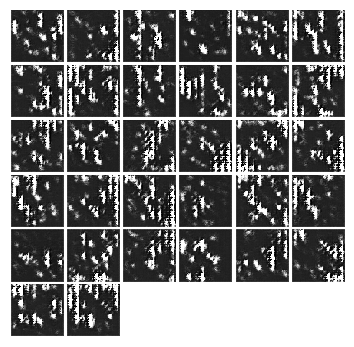


Iter: 200, D: 0.3906, G:2.075


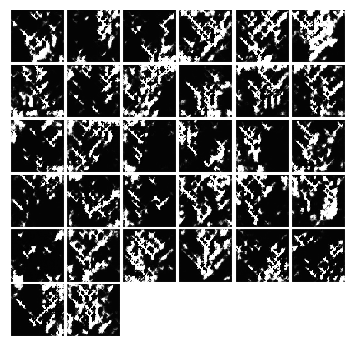


Iter: 300, D: 0.7183, G:2.052


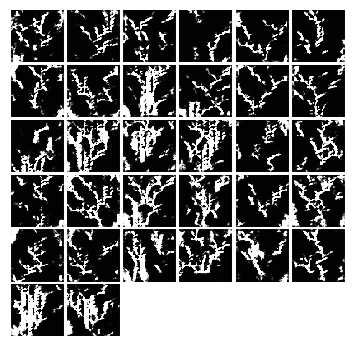


Iter: 400, D: 0.4432, G:1.376


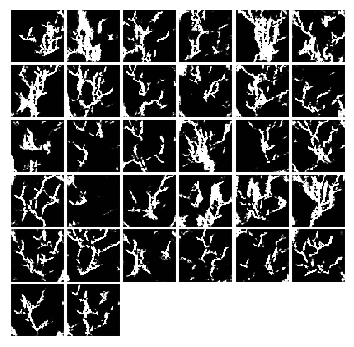


Iter: 500, D: 0.5645, G:1.086


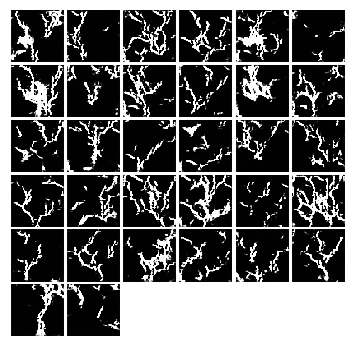


Iter: 600, D: 0.3223, G:1.621


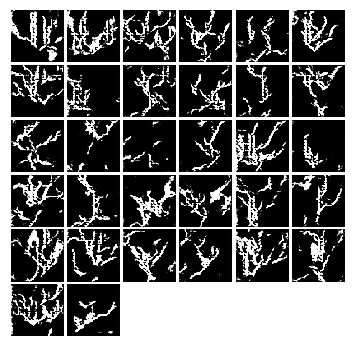


Iter: 700, D: 1.025, G:1.774


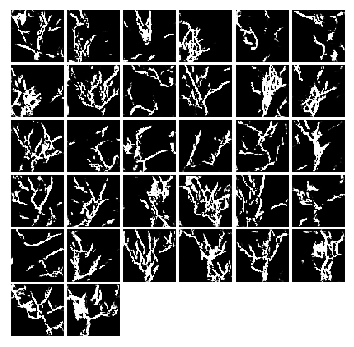


Iter: 800, D: 0.3983, G:1.898


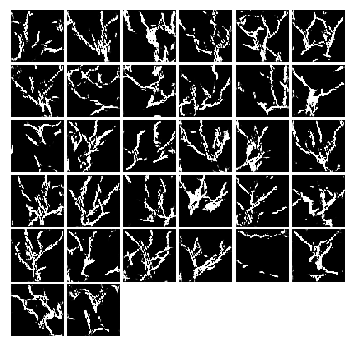


Iter: 900, D: 0.5892, G:2.069


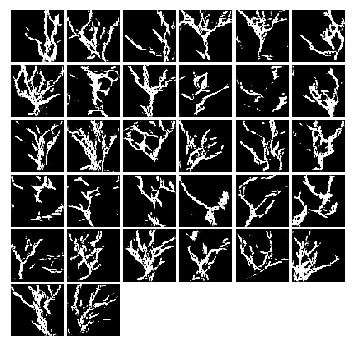


Iter: 1000, D: 1.013, G:1.363


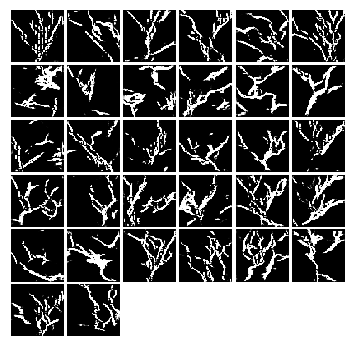


Iter: 1100, D: 0.2627, G:2.963


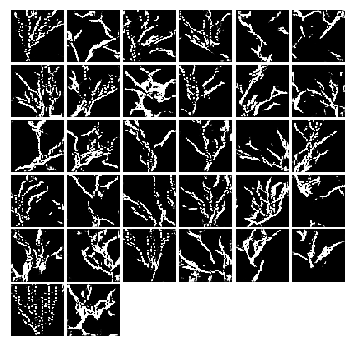


Iter: 1200, D: 0.419, G:2.045


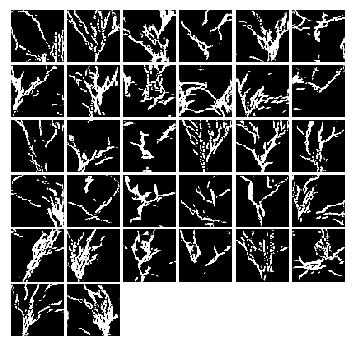


Iter: 1300, D: 0.3543, G:3.27


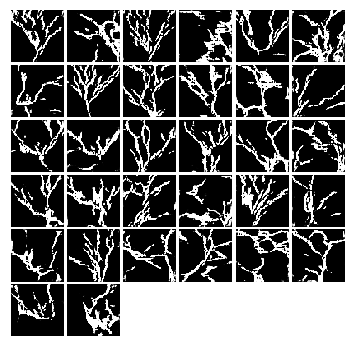


Iter: 1400, D: 0.5997, G:2.279


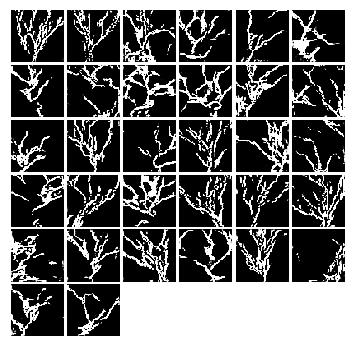


Iter: 1500, D: 0.3998, G:2.716


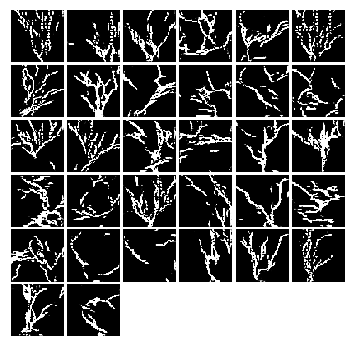


Iter: 1600, D: 0.1712, G:3.196


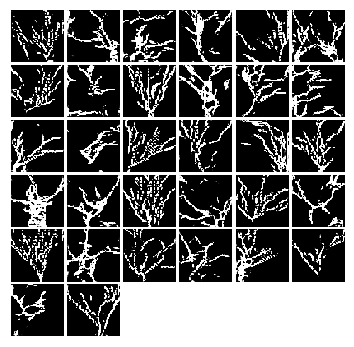


Iter: 1700, D: 0.761, G:1.602


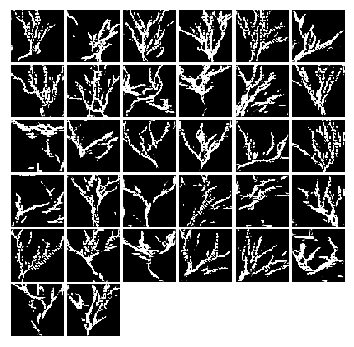


Iter: 1800, D: 1.231, G:1.851


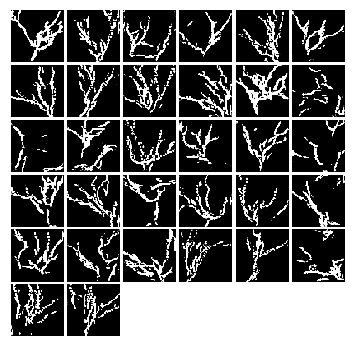


Iter: 1900, D: 0.1829, G:4.651


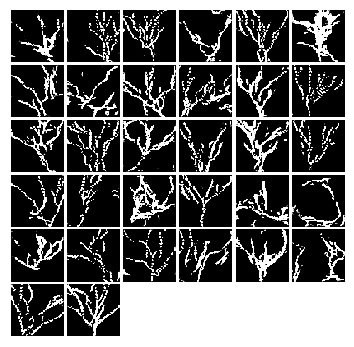


Iter: 2000, D: 1.647, G:8.34


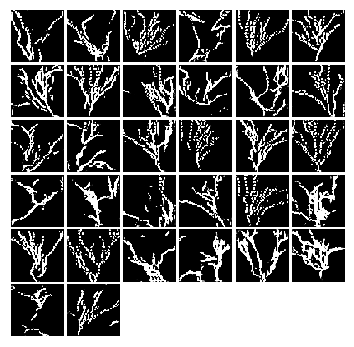


Iter: 2100, D: 0.1717, G:5.489


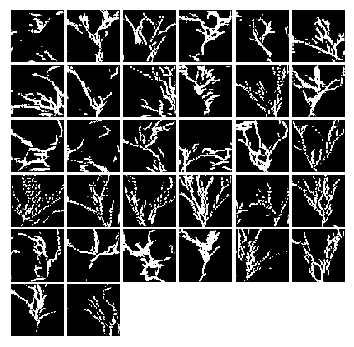


Iter: 2200, D: 0.128, G:5.118


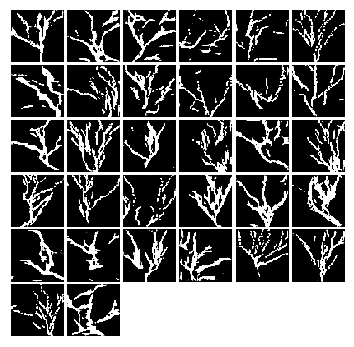


Iter: 2300, D: 0.2389, G:7.218


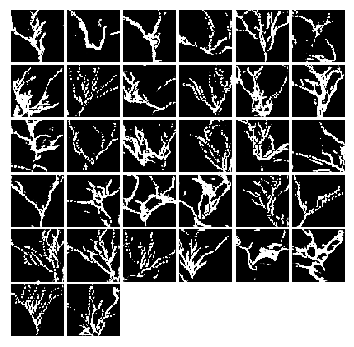


Iter: 2400, D: 0.08643, G:5.688


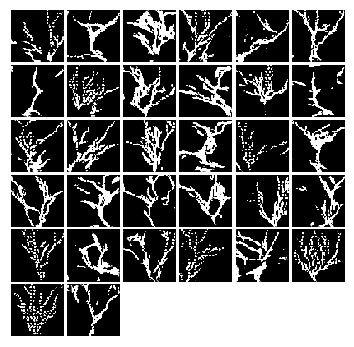


Iter: 2500, D: 0.3721, G:2.553


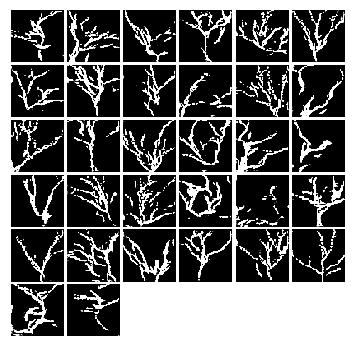


Iter: 2600, D: 0.2859, G:2.887


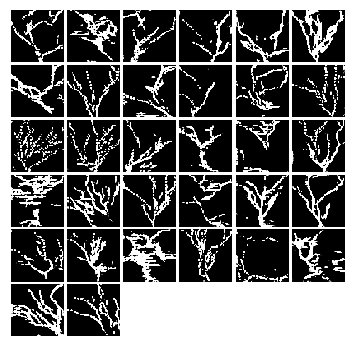


Iter: 2700, D: 4.433, G:5.733


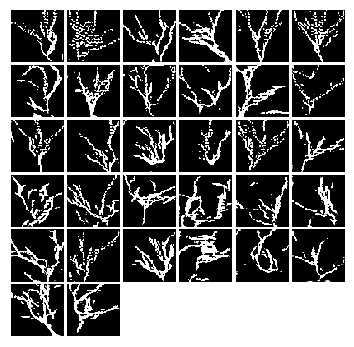


Iter: 2800, D: 0.09844, G:4.972


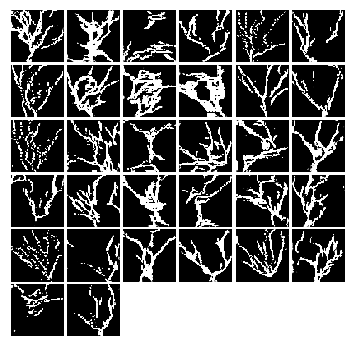


Iter: 2900, D: 0.08671, G:5.939


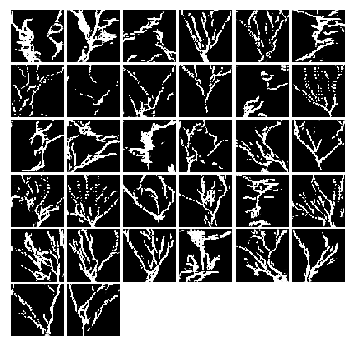


Iter: 3000, D: 0.1057, G:8.373


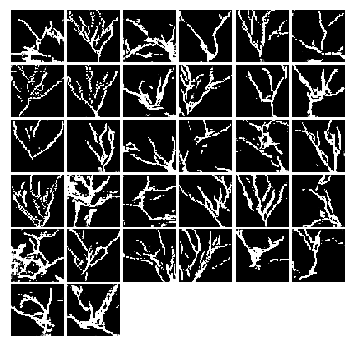


Iter: 3100, D: 0.1189, G:4.541


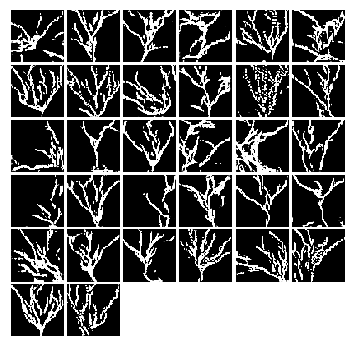


Iter: 3200, D: 0.4064, G:3.418


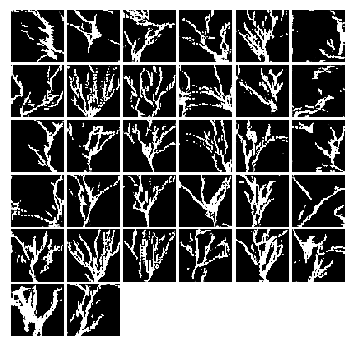


Iter: 3300, D: 0.152, G:4.783


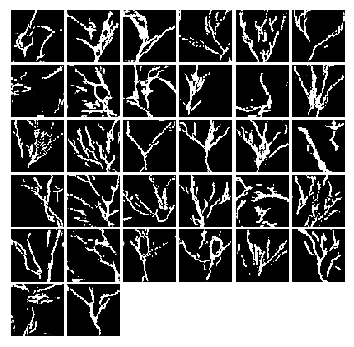


Iter: 3400, D: 1.182, G:0.6216


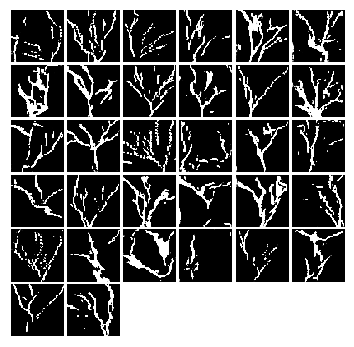


Iter: 3500, D: 0.8932, G:2.241


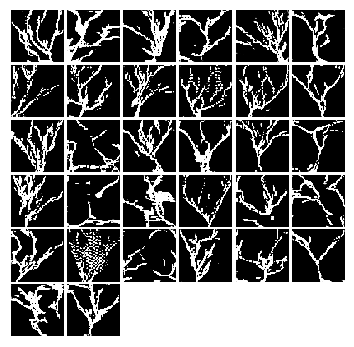


Iter: 3600, D: 0.2684, G:3.703


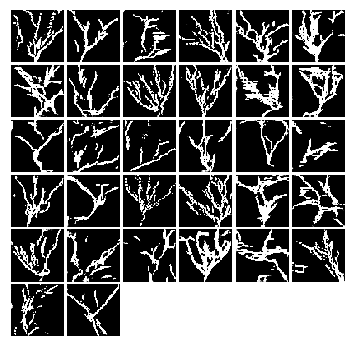


Iter: 3700, D: 0.2085, G:4.678


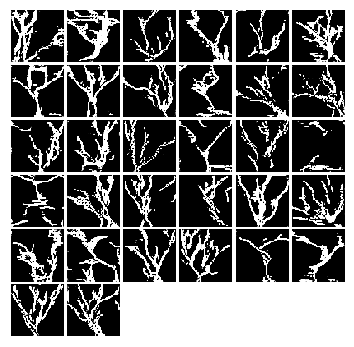


Iter: 3800, D: 0.138, G:4.276


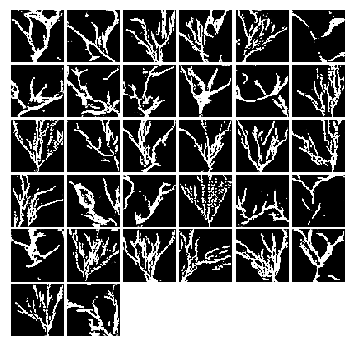


Iter: 3900, D: 0.147, G:5.81


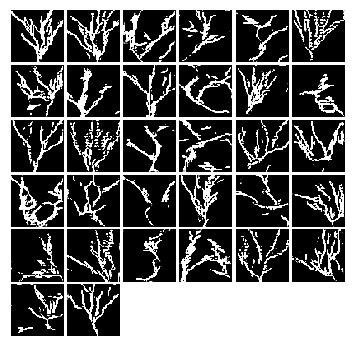


Iter: 4000, D: 0.102, G:6.67


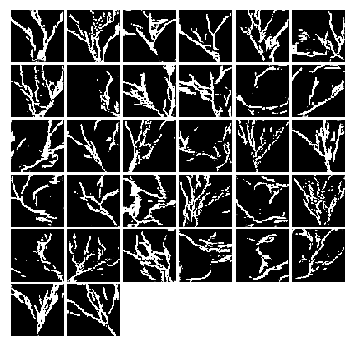


Iter: 4100, D: 0.08642, G:6.979


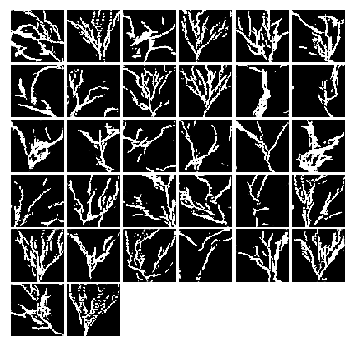


lr-0.00059510829414641-ls-0-in-1
Iter: 0, D: 1.361, G:0.412


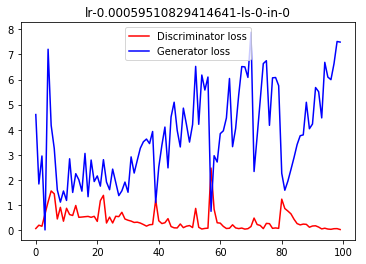

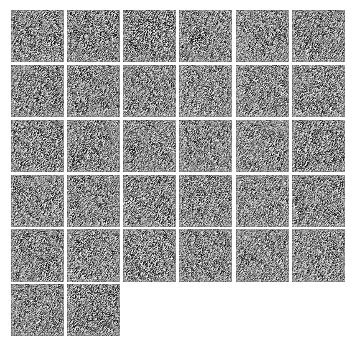


Iter: 100, D: 0.9953, G:0.1608


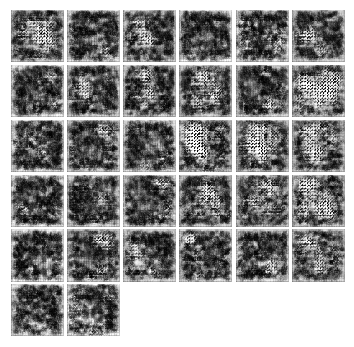


Iter: 200, D: 1.538, G:1.424


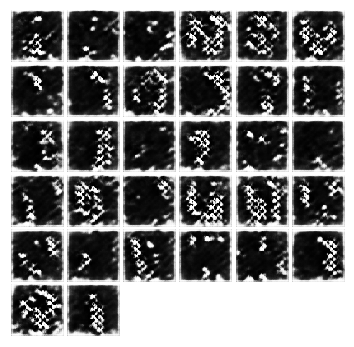


Iter: 300, D: 2.219, G:4.445


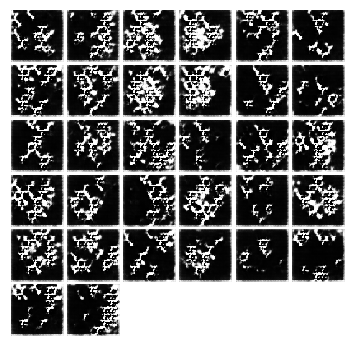


Iter: 400, D: 0.3858, G:2.949


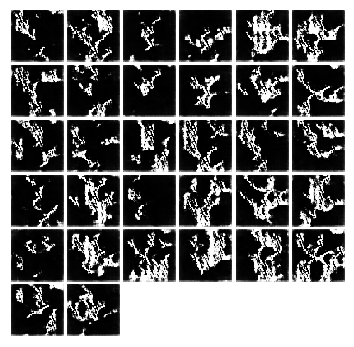


Iter: 500, D: 0.3086, G:2.202


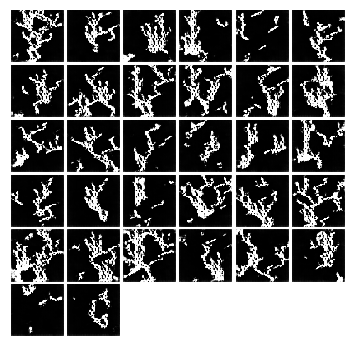


Iter: 600, D: 0.3093, G:2.466


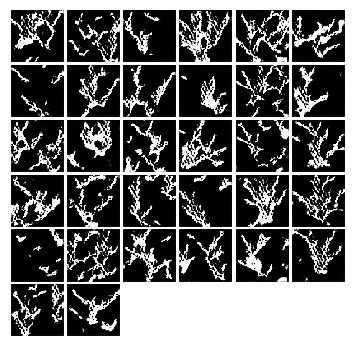


Iter: 700, D: 3.04, G:0.9055


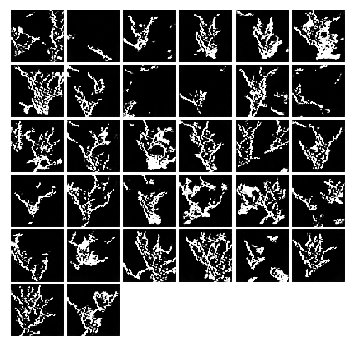


Iter: 800, D: 0.2478, G:3.118


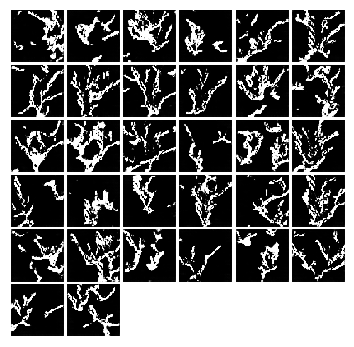


Iter: 900, D: 0.2015, G:3.021


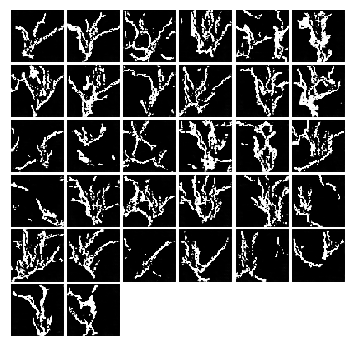


Iter: 1000, D: 0.2279, G:3.399


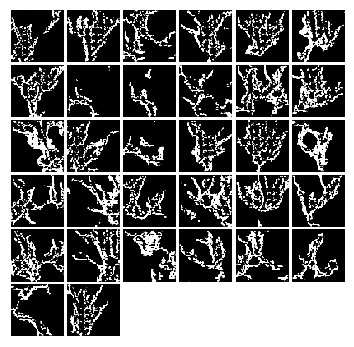


Iter: 1100, D: 0.2263, G:3.987


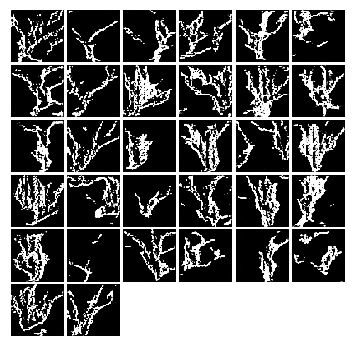


Iter: 1200, D: 0.1928, G:3.869


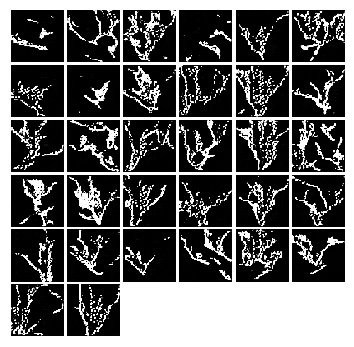


Iter: 1300, D: 0.2627, G:2.856


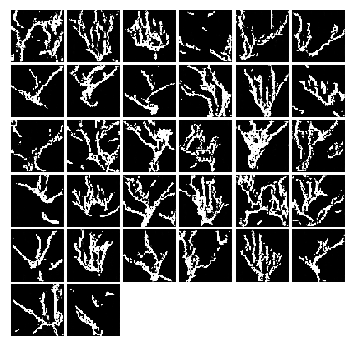


Iter: 1400, D: 0.2923, G:3.129


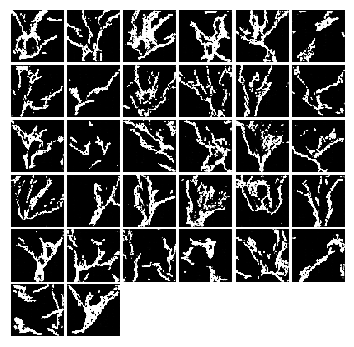


Iter: 1500, D: 0.2012, G:3.994


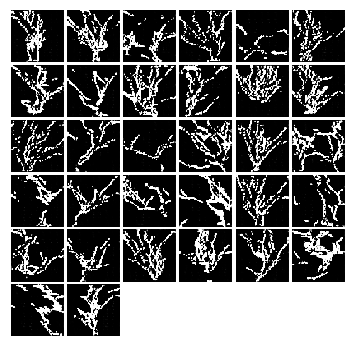


Iter: 1600, D: 0.4037, G:2.628


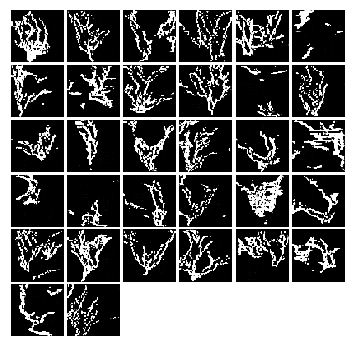


Iter: 1700, D: 0.1686, G:3.383


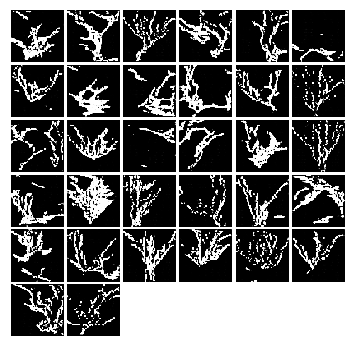


Iter: 1800, D: 0.1331, G:4.616


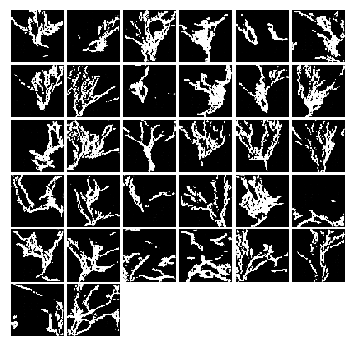


Iter: 1900, D: 0.2292, G:3.333


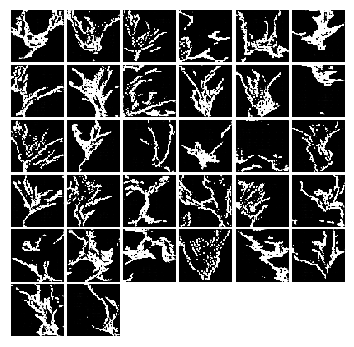


Iter: 2000, D: 0.1922, G:3.795


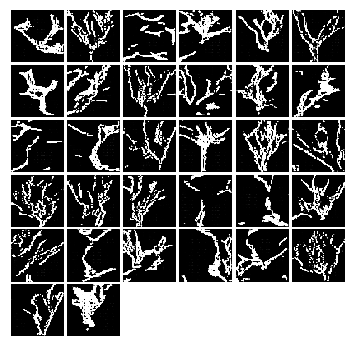


Iter: 2100, D: 0.1057, G:5.577


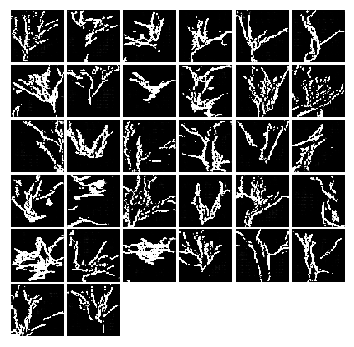


Iter: 2200, D: 0.1173, G:6.051


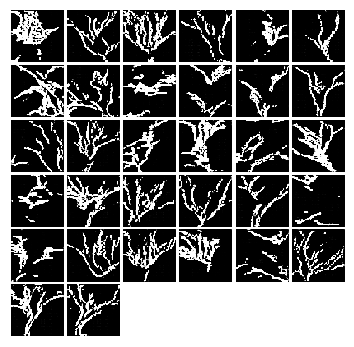


Iter: 2300, D: 0.1718, G:4.137


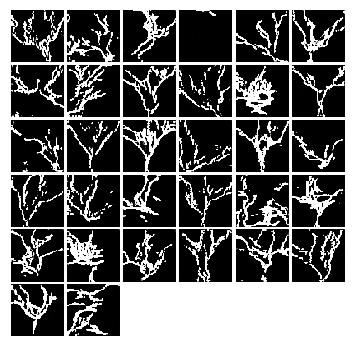


Iter: 2400, D: 0.2046, G:3.452


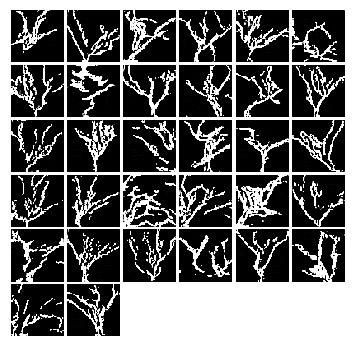


Iter: 2500, D: 0.1011, G:3.739


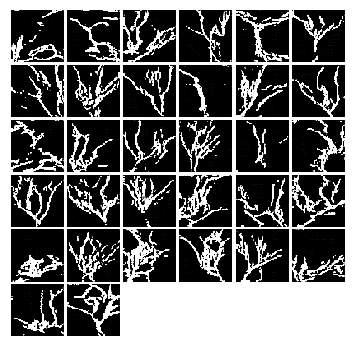


Iter: 2600, D: 0.3265, G:2.33


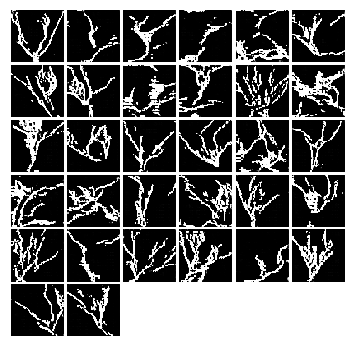


Iter: 2700, D: 0.05816, G:4.732


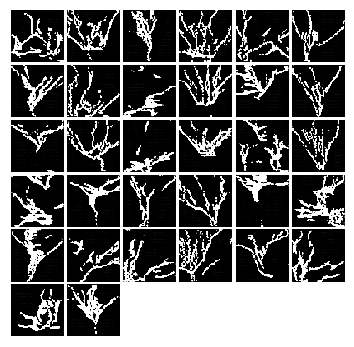


Iter: 2800, D: 0.5776, G:2.817


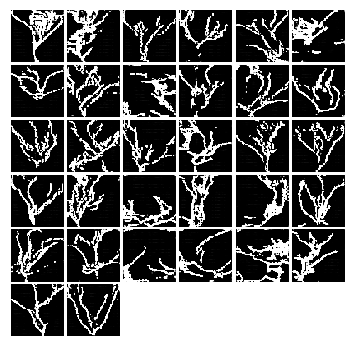


Iter: 2900, D: 0.2301, G:5.572


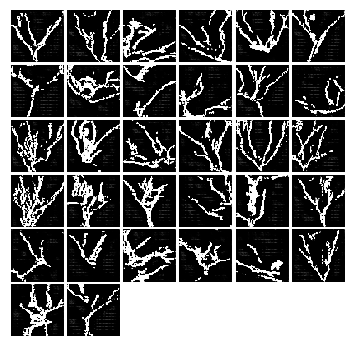


Iter: 3000, D: 0.07955, G:5.868


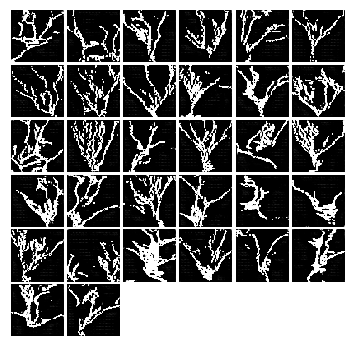


Iter: 3100, D: 0.1044, G:6.912


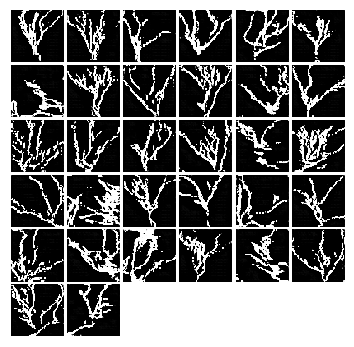


Iter: 3200, D: 0.08496, G:6.018


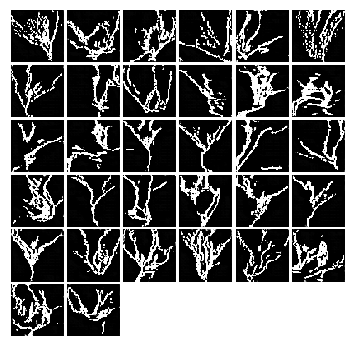


Iter: 3300, D: 0.4213, G:3.693


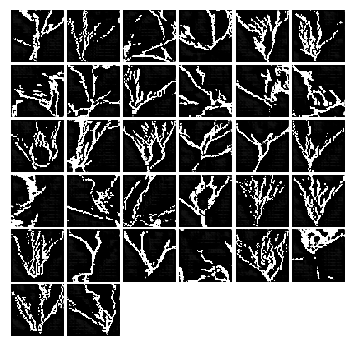


Iter: 3400, D: 0.05343, G:7.515


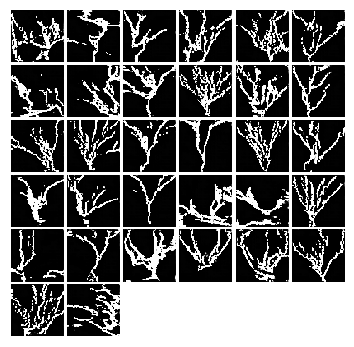


Iter: 3500, D: 0.05109, G:8.25


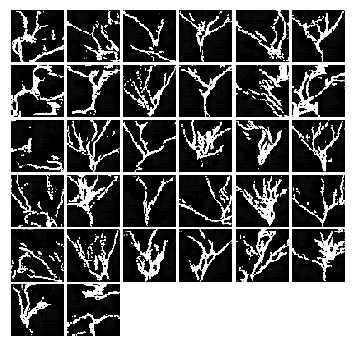


Iter: 3600, D: 0.2627, G:3.249


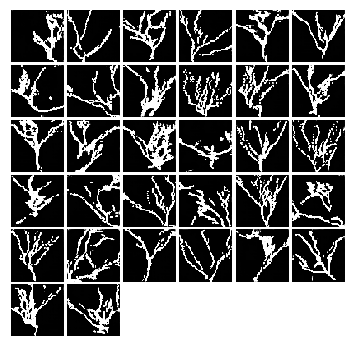


Iter: 3700, D: 0.4911, G:7.264


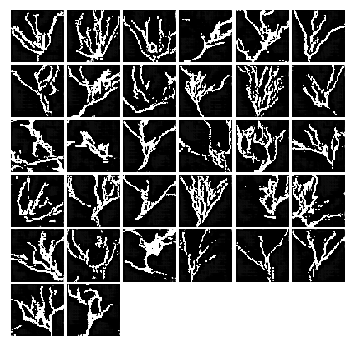


Iter: 3800, D: 0.04382, G:7.446


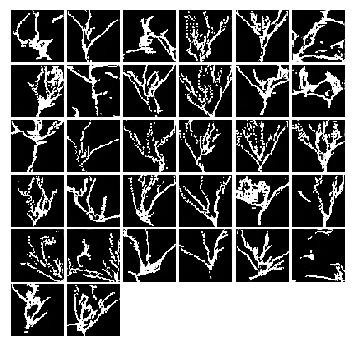


Iter: 3900, D: 0.01877, G:8.841


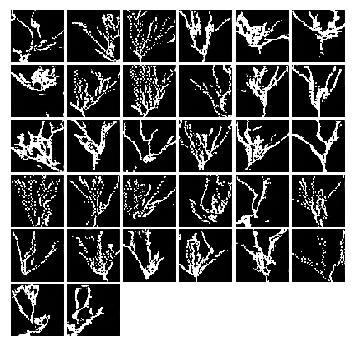


Iter: 4000, D: 0.01547, G:7.94


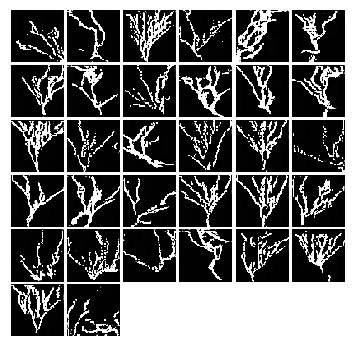


Iter: 4100, D: 0.0701, G:7.18


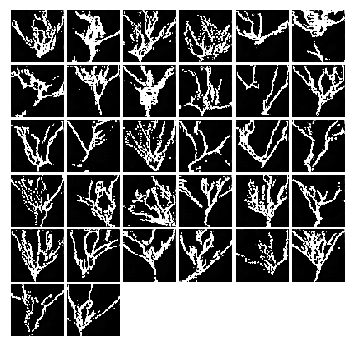


lr-0.00059510829414641-ls-1-in-0
Iter: 0, D: 1.462, G:1.591


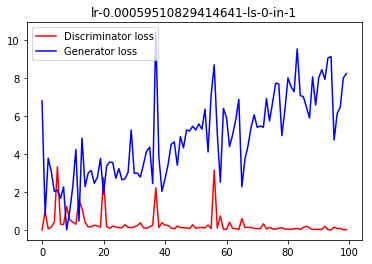

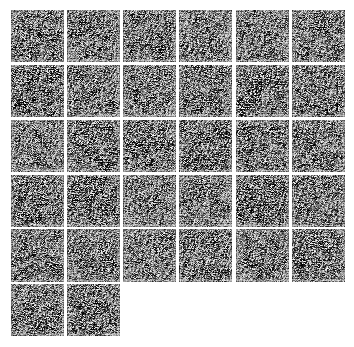


Iter: 100, D: 1.17, G:0.8587


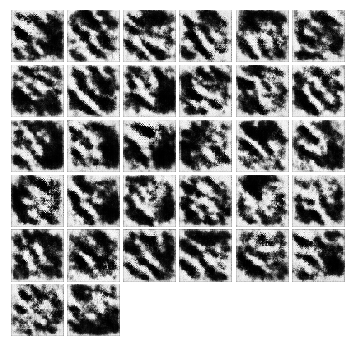


Iter: 200, D: 0.8951, G:0.5175


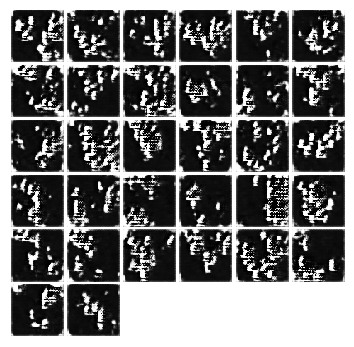


Iter: 300, D: 1.064, G:0.05569


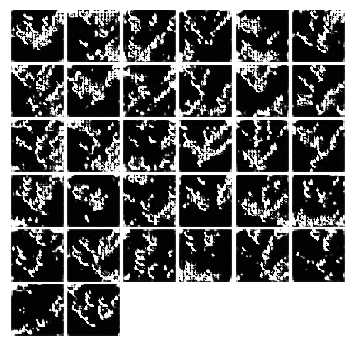


Iter: 400, D: 0.5939, G:1.458


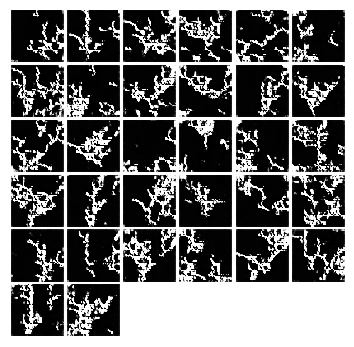


Iter: 500, D: 3.057, G:1.835


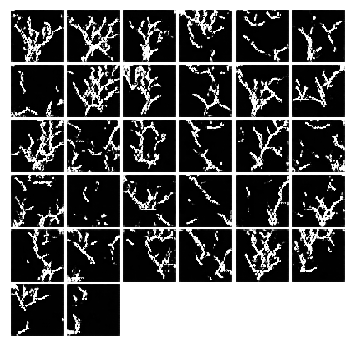


Iter: 600, D: 0.7183, G:0.5029


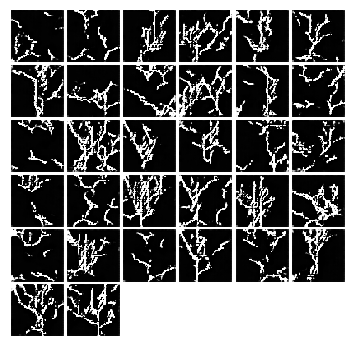


Iter: 700, D: 0.6456, G:2.865


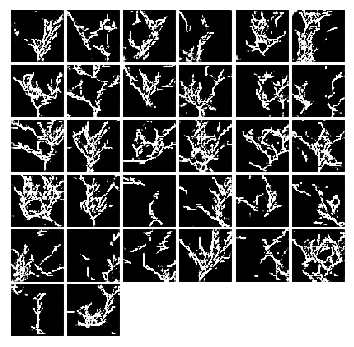


Iter: 800, D: 0.7157, G:1.29


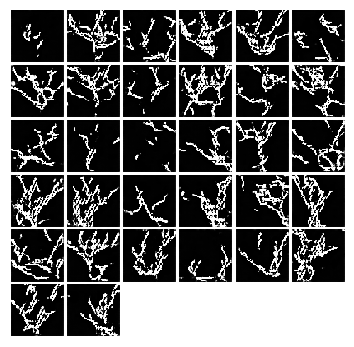


Iter: 900, D: 0.6268, G:1.587


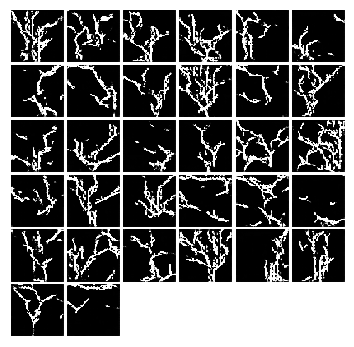


Iter: 1000, D: 0.5727, G:1.807


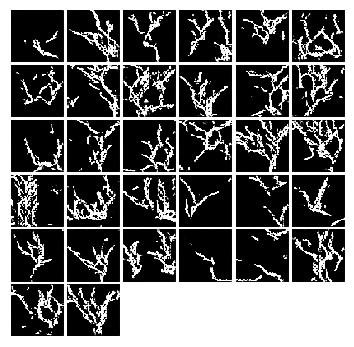


Iter: 1100, D: 0.5776, G:1.721


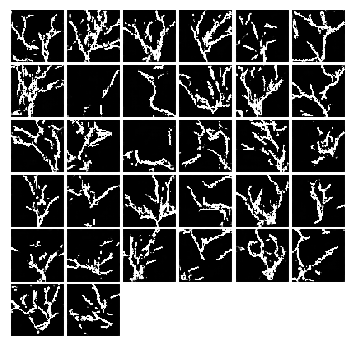


Iter: 1200, D: 0.5375, G:1.334


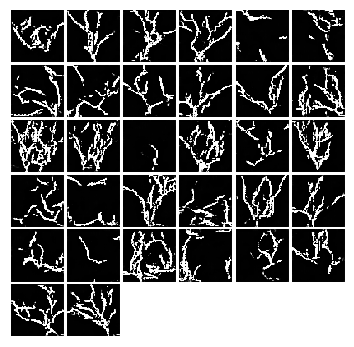


Iter: 1300, D: 2.705, G:1.447


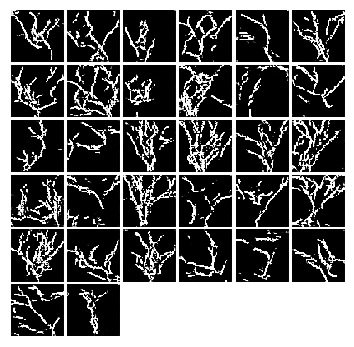


Iter: 1400, D: 0.5305, G:1.923


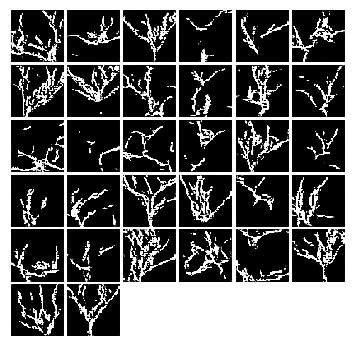


Iter: 1500, D: 0.5797, G:1.792


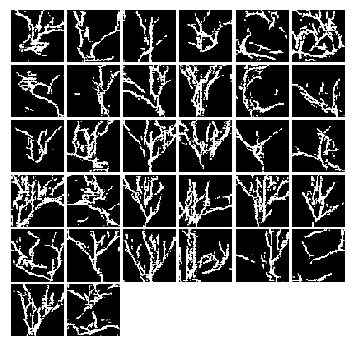


Iter: 1600, D: 0.6846, G:1.579


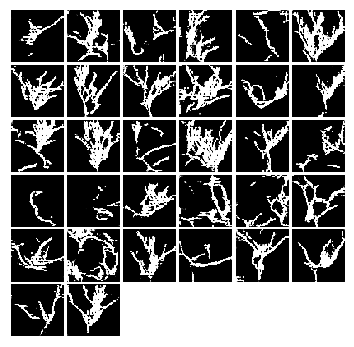


Iter: 1700, D: 2.02, G:0.9859


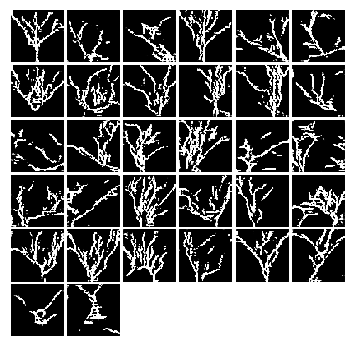


Iter: 1800, D: 0.6653, G:1.37


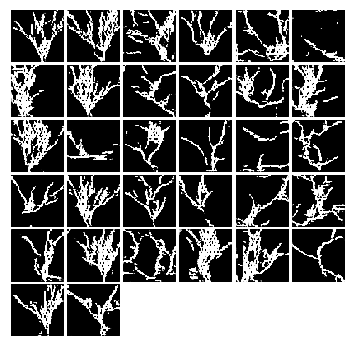


Iter: 1900, D: 0.4148, G:1.947


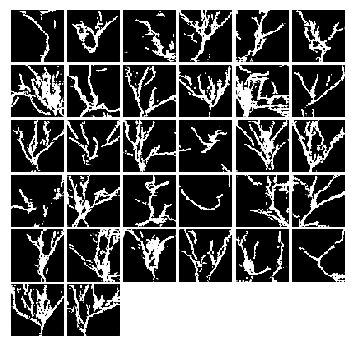


Iter: 2000, D: 0.7699, G:1.376


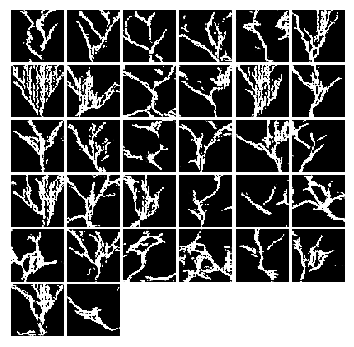


Iter: 2100, D: 0.476, G:1.514


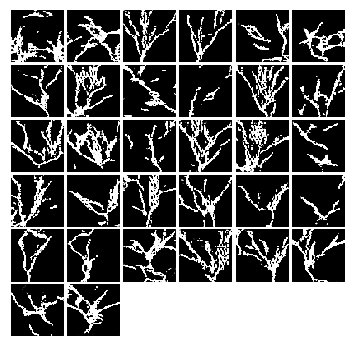


Iter: 2200, D: 0.388, G:2.044


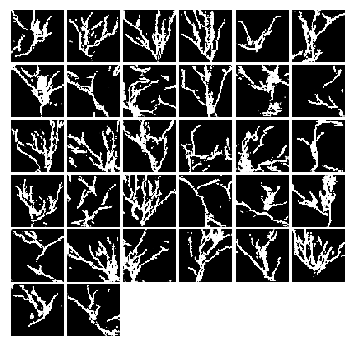


Iter: 2300, D: 0.4346, G:1.95


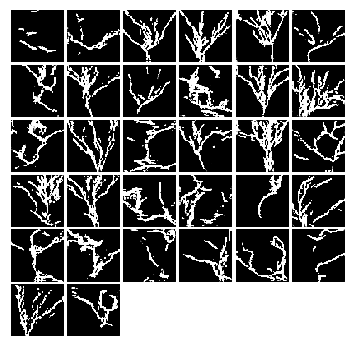


Iter: 2400, D: 0.4922, G:4.74


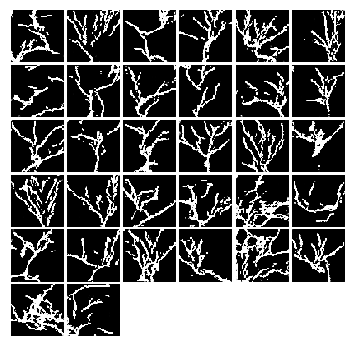


Iter: 2500, D: 0.4784, G:1.842


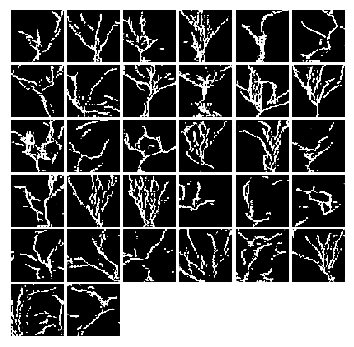


Iter: 2600, D: 0.6931, G:1.396


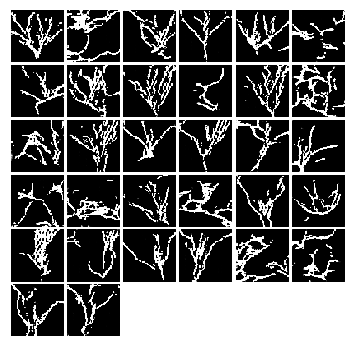


Iter: 2700, D: 0.4383, G:1.903


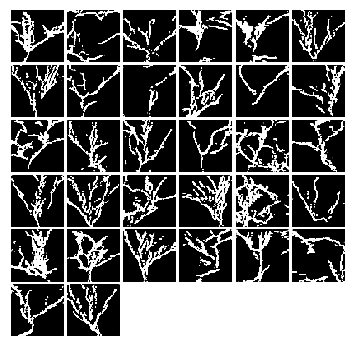


Iter: 2800, D: 0.4934, G:1.705


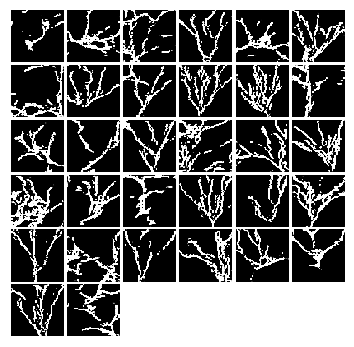


Iter: 2900, D: 0.3718, G:2.03


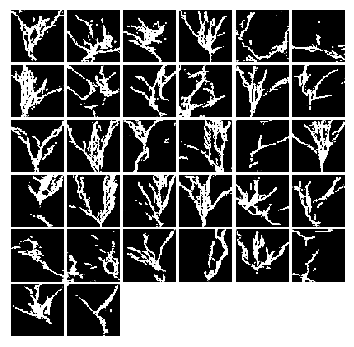


Iter: 3000, D: 0.4749, G:1.479


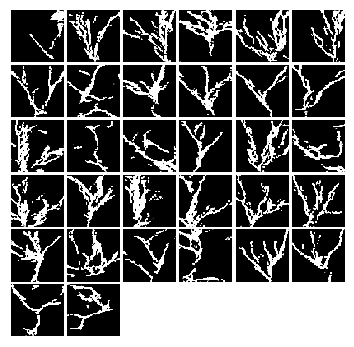


Iter: 3100, D: 0.4765, G:1.8


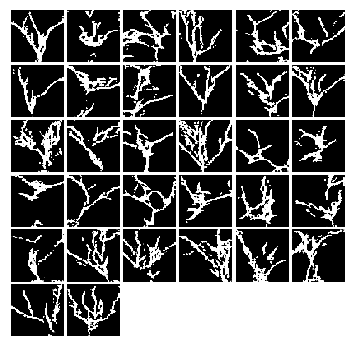


Iter: 3200, D: 0.5243, G:1.755


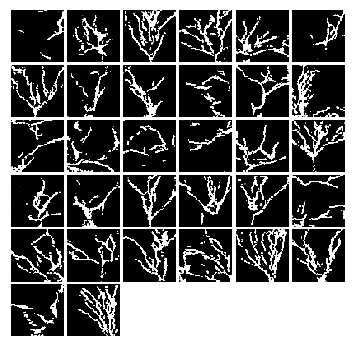


Iter: 3300, D: 0.2289, G:2.875


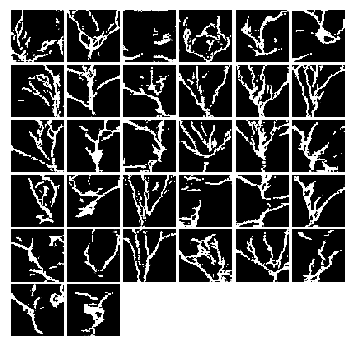


Iter: 3400, D: 0.7996, G:2.297


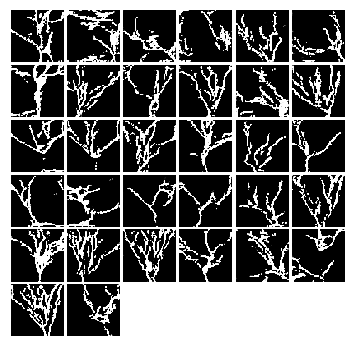


Iter: 3500, D: 3.972, G:2.507


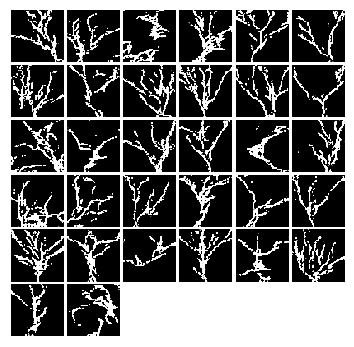


Iter: 3600, D: 0.4625, G:1.669


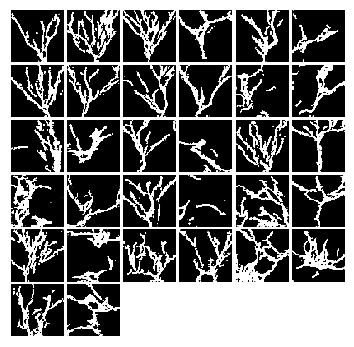


Iter: 3700, D: 0.8597, G:1.93


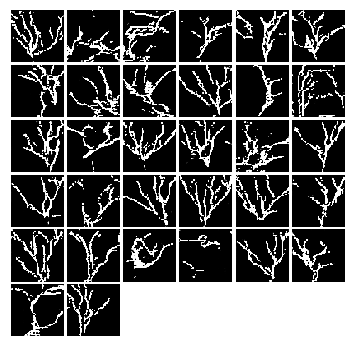


Iter: 3800, D: 0.5353, G:2.196


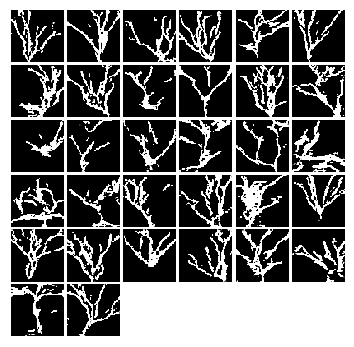


Iter: 3900, D: 0.8747, G:1.091


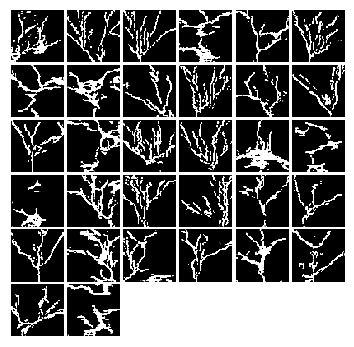


Iter: 4000, D: 0.4907, G:1.932


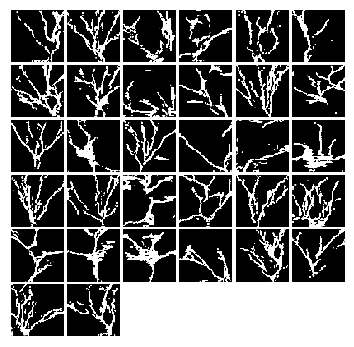


Iter: 4100, D: 0.3621, G:2.024


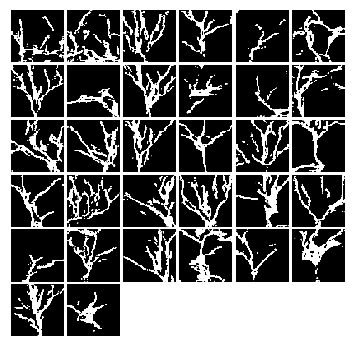


lr-0.00059510829414641-ls-1-in-1
Iter: 0, D: 1.411, G:0.5583


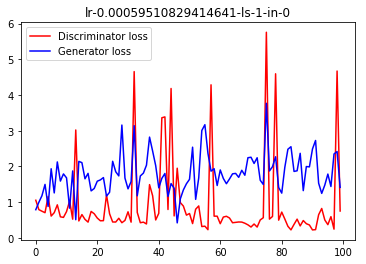

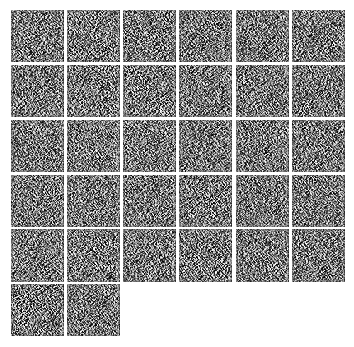


Iter: 100, D: 0.5836, G:1.588


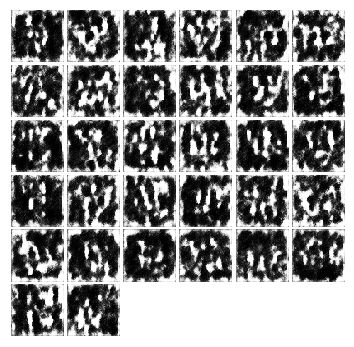


Iter: 200, D: 0.7877, G:1.262


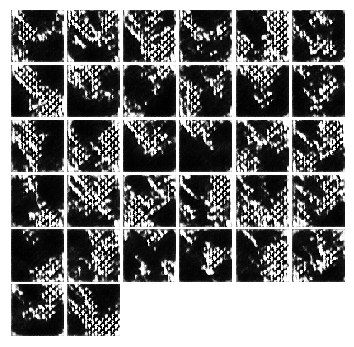


Iter: 300, D: 0.675, G:1.049


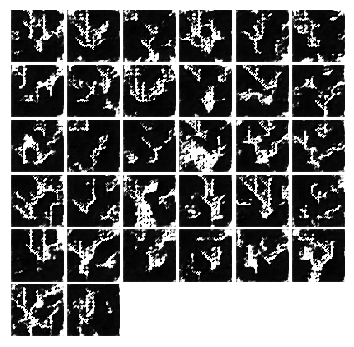


Iter: 400, D: 0.5118, G:0.711


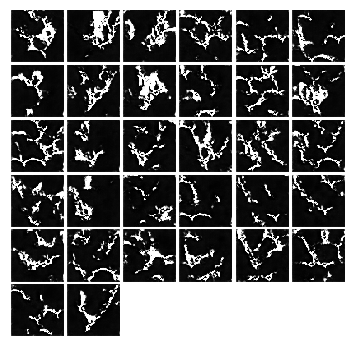


Iter: 500, D: 0.6115, G:1.532


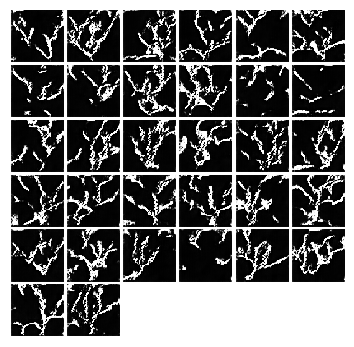


Iter: 600, D: 1.211, G:0.1011


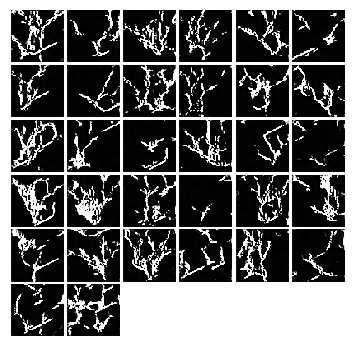


Iter: 700, D: 0.7905, G:1.412


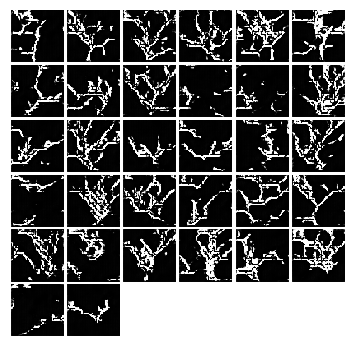


Iter: 800, D: 0.5767, G:1.625


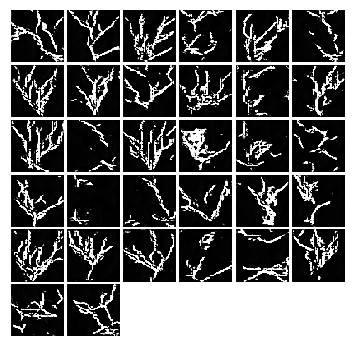


Iter: 900, D: 0.669, G:1.866


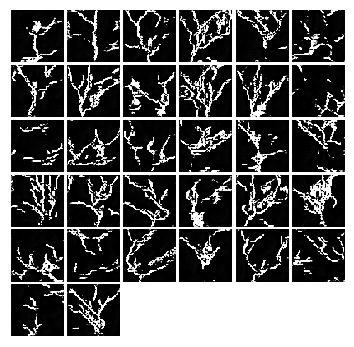


Iter: 1000, D: 0.6819, G:1.341


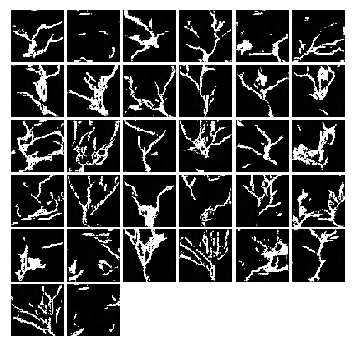


Iter: 1100, D: 0.5331, G:1.977


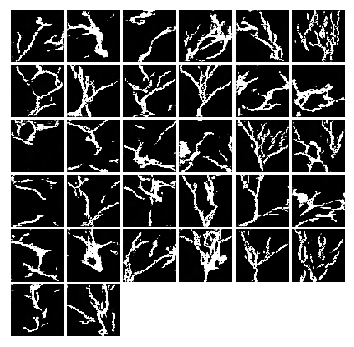


Iter: 1200, D: 0.6969, G:1.652


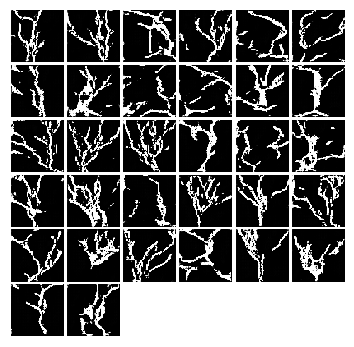


Iter: 1300, D: 0.6693, G:1.618


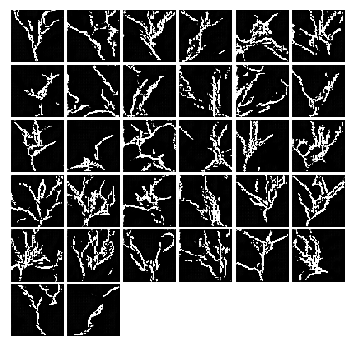


Iter: 1400, D: 0.6947, G:1.269


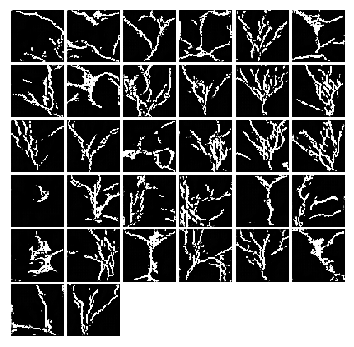


Iter: 1500, D: 0.4551, G:2.354


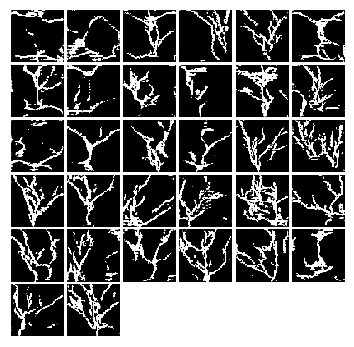


Iter: 1600, D: 0.6478, G:1.584


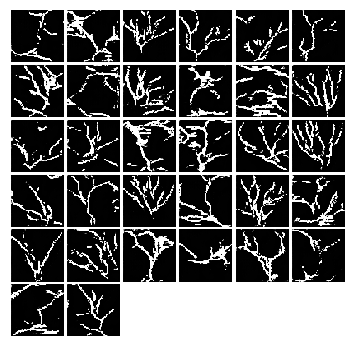


Iter: 1700, D: 0.7233, G:1.624


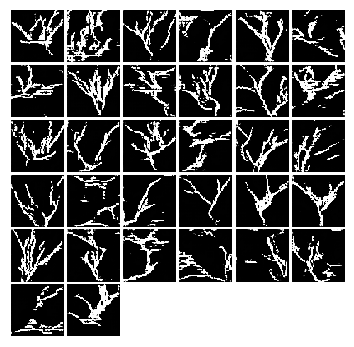


Iter: 1800, D: 0.6144, G:1.688


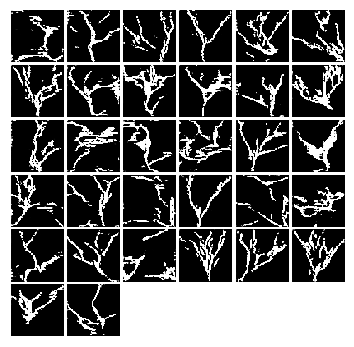


Iter: 1900, D: 0.5696, G:1.704


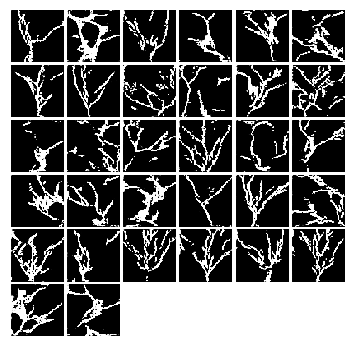


Iter: 2000, D: 0.5591, G:1.81


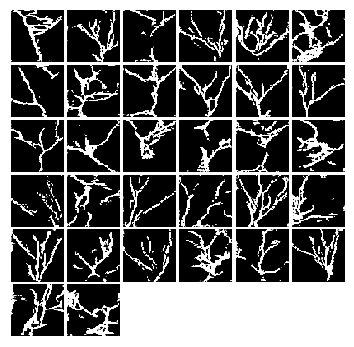


Iter: 2100, D: 0.4682, G:1.867


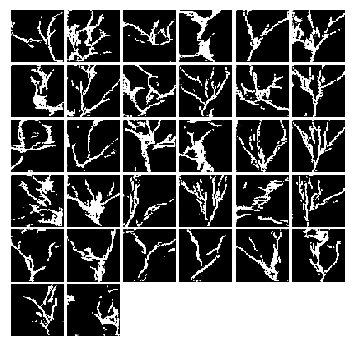


Iter: 2200, D: 0.3496, G:2.441


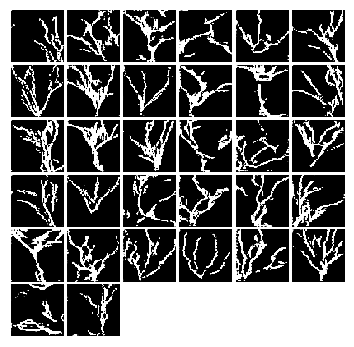


Iter: 2300, D: 0.3304, G:2.289


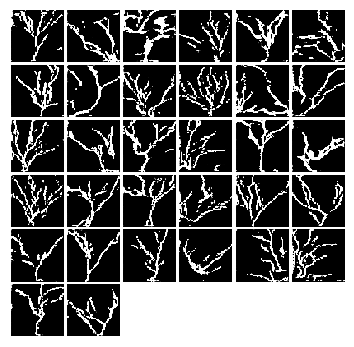


Iter: 2400, D: 0.3621, G:2.186


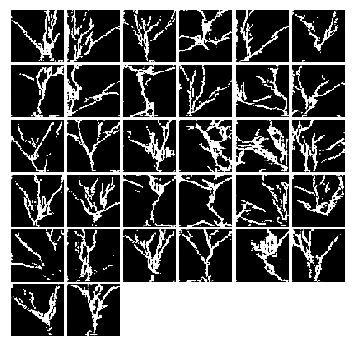


Iter: 2500, D: 0.3812, G:2.037


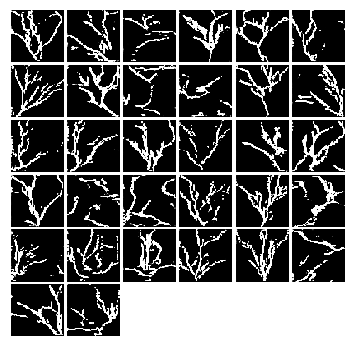


Iter: 2600, D: 0.2971, G:2.21


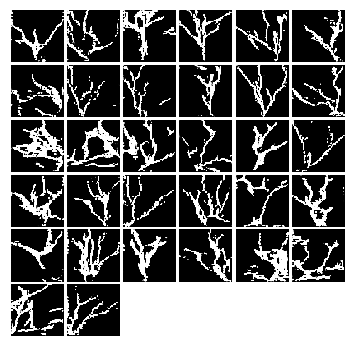


Iter: 2700, D: 1.032, G:1.053


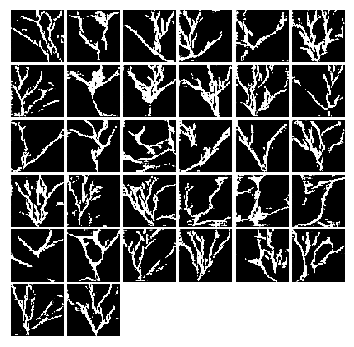


Iter: 2800, D: 2.349, G:1.097


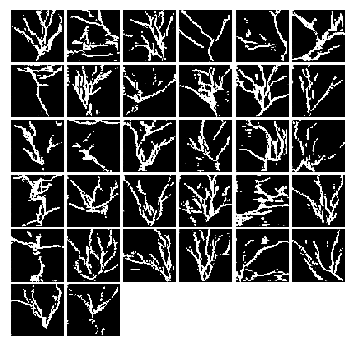


Iter: 2900, D: 0.5953, G:1.757


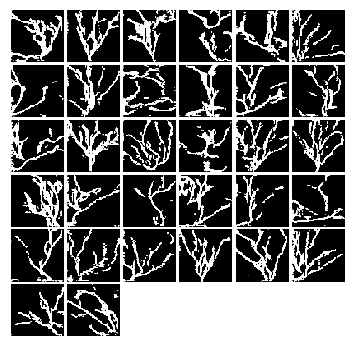


Iter: 3000, D: 0.5875, G:1.678


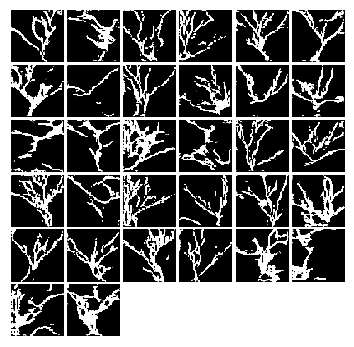


Iter: 3100, D: 0.2479, G:2.702


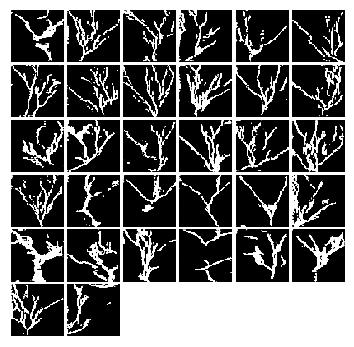


Iter: 3200, D: 0.5613, G:1.76


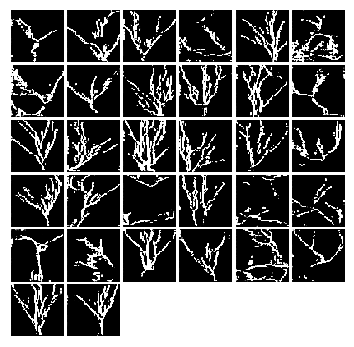


Iter: 3300, D: 0.3418, G:2.389


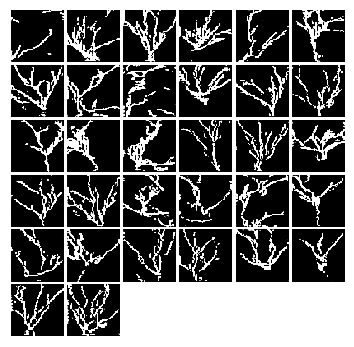


Iter: 3400, D: 0.509, G:1.598


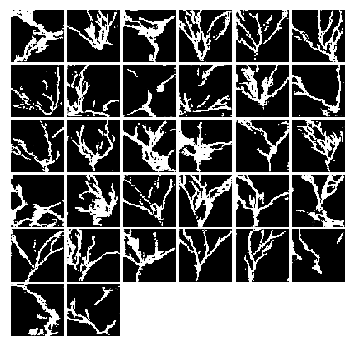


Iter: 3500, D: 0.5878, G:1.979


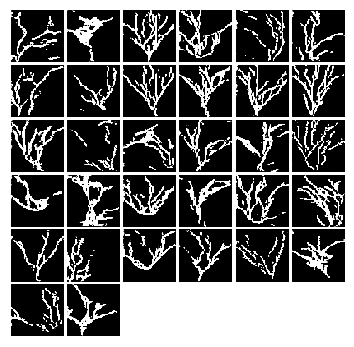


Iter: 3600, D: 0.7407, G:1.304


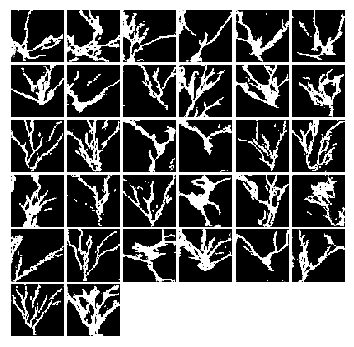


Iter: 3700, D: 0.3813, G:2.235


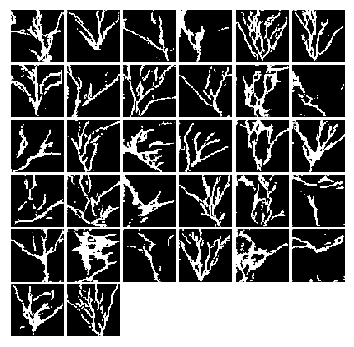


Iter: 3800, D: 0.1712, G:3.027


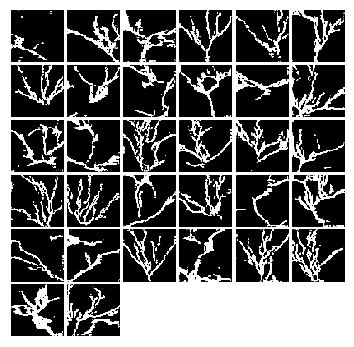


Iter: 3900, D: 0.2592, G:2.875


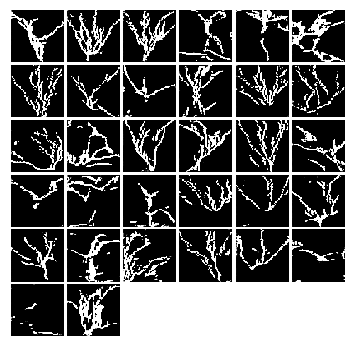


Iter: 4000, D: 0.4893, G:2.288


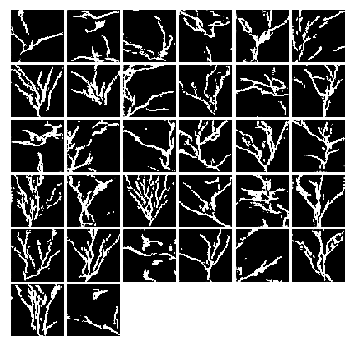


Iter: 4100, D: 0.4299, G:1.848


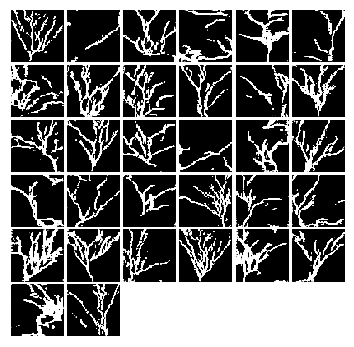

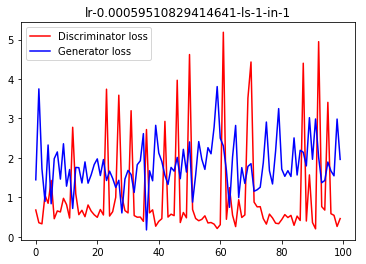

In [19]:

# lr_list = []
# for lr in results_dg.keys():
#     lr_list.append(lr)
# print(lr_list)
# # user needs to pluck out index of ideal learning rate
# ideal_lr_index = 7
# lr_best = lr_list[ideal_lr_index] # 0.00059510829414641


lr_best = 0.00059510829414641
dtype = torch.cuda.FloatTensor
print(lr_best)
for i in range(0,2):
    for j in range(0,2):
        title = 'lr-' + str(lr_best) + '-ls-' + str(i) + '-in-' + str(j)
        print(title)
        d_loss_list, g_loss_list, fake_imgs, D, G = dg_gan_run(dtype, lr_best, lr_best, 0.50, 0.999, num_epochs=100, 
                                                       show=True, return_model=True, label_smoothing=i, instance_noise=j)
        plot_loss(d_loss_list, g_loss_list, title=title)
        save_model(D, 'trained-granule-discriminator-ls-'+str(i)+'-in-'+str(j)+'.pt')
        save_model(G, 'trained-granule-generator-ls-'+str(i)+'-in-'+str(j)+'.pt')
